In [1]:
import sys
!{sys.executable} -m pip install torchscan torchsummary

In [2]:
import argparse
import os
import random
import math

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as vdatasets
import torchvision.transforms as T
import torchvision.utils as vutils

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import seaborn as sns
import pandas as pd

from IPython.display import HTML

from torchscan import summary
# from torchsummary import summary

import tqdm
from tqdm.notebook import tqdm as tqdm_nb

import warnings
warnings.filterwarnings("ignore")

os.environ['TORCH_HOME'] = '~/pytorch/torch_home'
os.environ['CUDA_LAUNCH_BLOCKING'] = "1"
os.environ["CUDA_VISIBLE_DEVICES"] = "0"

manualSeed = 999
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [3]:
# Root directory for dataset
dataroot = './CelebA'

# Number of workers for dataloader
workers = 16

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 30

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

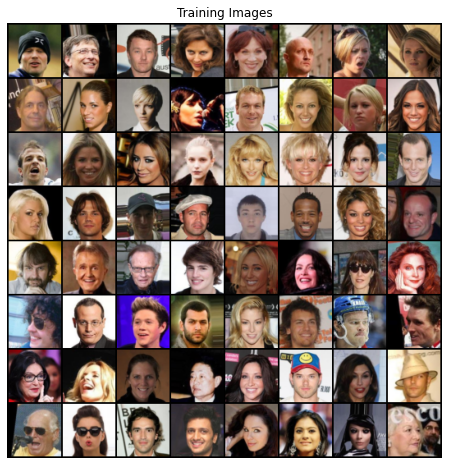

In [4]:
dataset = vdatasets.ImageFolder(root=os.path.join(dataroot, 'img_align_celeba'),
                                transform=T.Compose([
                                    T.Resize(image_size),
                                    T.CenterCrop(image_size),
                                    T.ToTensor(),
                                    T.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                                ]))
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

device = torch.device('cuda' if (torch.cuda.is_available() and ngpu > 0) else 'cpu')

one_batch = next(iter(dataloader))
plt.figure(figsize=(8, 8))
plt.axis('off')
plt.title('Training Images')
plt.imshow(np.transpose(vutils.make_grid(one_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [5]:
# custom weights initialization called on netG and netD
def weights_init(m):
    if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif isinstance(m, nn.BatchNorm2d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [6]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [7]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.02.
netG.apply(weights_init)

# Print the model
summary(netG, (nz, 1, 1))

__________________________________________________________________________________________
Layer                        Type                  Output Shape              Param #        
generator                    Generator             (-1, 3, 64, 64)           0              
├─main                       Sequential            (-1, 3, 64, 64)           0              
|    └─0                     ConvTranspose2d       (-1, 512, 4, 4)           819,200        
|    └─1                     BatchNorm2d           (-1, 512, 4, 4)           2,049          
|    └─2                     ReLU                  (-1, 512, 4, 4)           0              
|    └─3                     ConvTranspose2d       (-1, 256, 8, 8)           2,097,152      
|    └─4                     BatchNorm2d           (-1, 256, 8, 8)           1,025          
|    └─5                     ReLU                  (-1, 256, 8, 8)           0              
|    └─6                     ConvTranspose2d       (-1, 128, 16, 16)    

In [8]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            # nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [9]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
summary(netD, (3, 64, 64))

__________________________________________________________________________________________
Layer                        Type                  Output Shape              Param #        
discriminator                Discriminator         (-1, 1, 1, 1)             0              
├─main                       Sequential            (-1, 1, 1, 1)             0              
|    └─0                     Conv2d                (-1, 64, 32, 32)          3,072          
|    └─1                     LeakyReLU             (-1, 64, 32, 32)          0              
|    └─2                     Conv2d                (-1, 128, 16, 16)         131,072        
|    └─3                     BatchNorm2d           (-1, 128, 16, 16)         513            
|    └─4                     LeakyReLU             (-1, 128, 16, 16)         0              
|    └─5                     Conv2d                (-1, 256, 8, 8)           524,288        
|    └─6                     BatchNorm2d           (-1, 256, 8, 8)      

In [10]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [11]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []

total_steps = num_epochs * len(dataloader)
fig_save_interval = total_steps // 30   # animation can contain max 36 images

pbar = tqdm_nb()

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    pbar.reset(total=len(dataloader))
    for i, data in enumerate(dataloader, 0):
        pbar.update()
        piter = i / len(dataloader) * 100.
        ################################################################
        # (1) Update D network: maximize D(x) + D(G(z)) 5 times
        ################################################################
        ## Train with all-real batch
        netD.zero_grad()
        
        real_img = data[0].to(device)
        b_size = real_img.size(0)
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake_img = netG(noise)
        
        errD = -torch.mean(netD(real_img)) + torch.mean(netD(fake_img)) # Wasserstein
        errD.backward()
        optimizerD.step()
        
        # Clip weights of discriminator
        for p in netD.parameters():
            p.data.clamp_(-0.01, 0.01) # numbers from a paper
        
        # Train Generator for every 5 steps
        if i % 5 == 0:
            ################################################################
            # (2) Update G network: maximize D(G(z)
            ################################################################
            netG.zero_grad()

            gen_img = netG(noise)
            errG = -torch.mean(netD(gen_img))
            errG.backward()
            optimizerG.step()

            # Output training stats
            desc = '[%d/%d][%d/%d] Loss_D: %.4f Loss_G: %.4f' \
                    % (epoch+1, num_epochs, i, len(dataloader), errD.item(), errG.item())
            pbar.set_description(desc)

            # Save Losses for plotting later
            G_losses.append(errG.item())
            D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if piter % fig_save_interval == 0:
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append((epoch+1, i, vutils.make_grid(fake, padding=2, normalize=True)))

pbar.refresh()

0it [00:00, ?it/s]

Starting Training Loop...


True

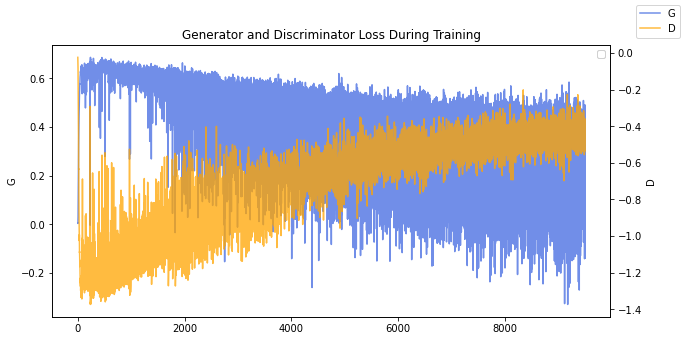

In [12]:
plt.figure(figsize=(10, 5))
plt.title("Generator and Discriminator Loss During Training")
df = pd.DataFrame({'G': G_losses[1:], 'D': D_losses[1:]})
ax1 = sns.lineplot(data=df, x=df.index, y='G', label='G', color='royalblue', alpha=.75)
ax2 = ax1.twinx()
sns.lineplot(data=df, x=df.index, y='D', label='D', color='orange', alpha=.75, ax=ax2)
for ax in [ax1, ax2]:
#     ax.set_ylim(bottom=0.)
    ax.legend([])
ax1.figure.legend()
plt.show()

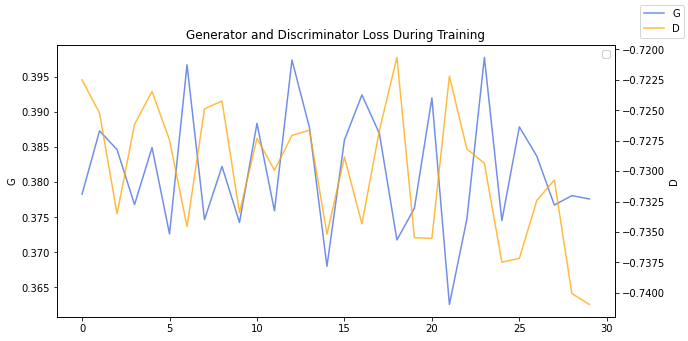

In [32]:
plt.figure(figsize=(10, 5))
plt.title("Generator and Discriminator Loss During Training")
df = pd.DataFrame({
    'G': np.mean(np.array(G_losses).reshape(len(G_losses) // num_epochs, -1), axis=0),
    'D': np.mean(np.array(D_losses).reshape(len(D_losses) // num_epochs, -1), axis=0)
})
ax1 = sns.lineplot(data=df, x=df.index, y='G', label='G', color='royalblue', alpha=.75)
ax2 = ax1.twinx()
sns.lineplot(data=df, x=df.index, y='D', label='D', color='orange', alpha=.75, ax=ax2)
for ax in [ax1, ax2]:
#     ax.set_ylim(bottom=0.)
    ax.legend([])
ax1.figure.legend()
plt.show()

Animation size has reached 21321961 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


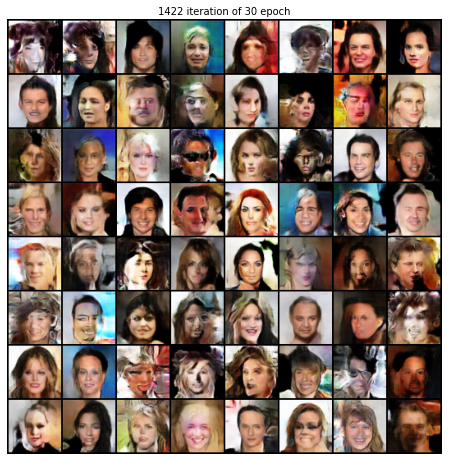

In [14]:
fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(111)
plt.axis('off')
imgs = [[
    plt.imshow(np.transpose(img, (1,2,0)), animated=True),
    plt.text(0.5, 1.01, f'{step} iteration of {epoch} epoch', horizontalalignment='center', transform=ax.transAxes),
] for epoch, step, img in img_list[::7]]

ani = animation.ArtistAnimation(fig, imgs, interval=1000, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

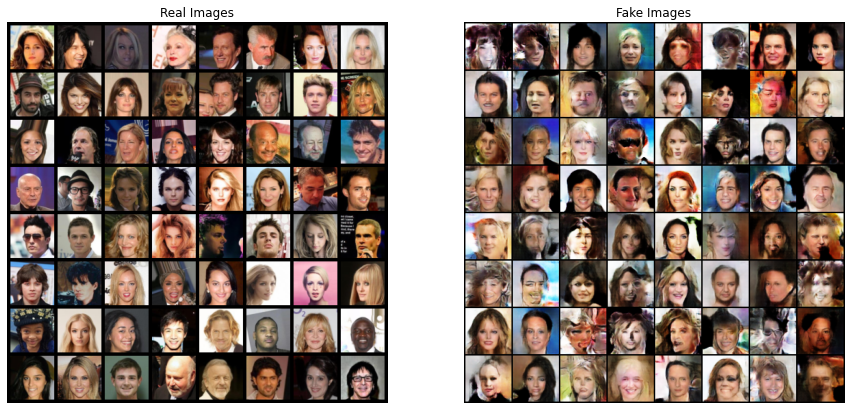

In [15]:
real_batch = next(iter(dataloader))

plt.figure(figsize=(15, 15))

plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1][-1],(1,2,0)))
plt.show()

# Interpolation

In [16]:
def interpolate_points(p1, p2, n_steps=10):
    ratios = np.linspace(0, 1, num=n_steps)
    vs = []
    for ratio in ratios:
        v = (1.0 - ratio) * p1 + ratio * p2
        vs.append(v)
    return torch.stack(vs)

In [45]:
left = [22,3,6,7,2]
right = [45,25,26,48,49]
n1 = fixed_noise[left].to(device)
n2 = fixed_noise[right].to(device)
# n1 = torch.randn(5, nz, 1, 1, device=device)
# n2 = torch.randn(5, nz, 1, 1, device=device)
fake = []
for i in range(5):
    point = interpolate_points(n1[i], n2[i]).to(device)
    fake.append(netG(point))
fake = torch.vstack(fake).cpu()

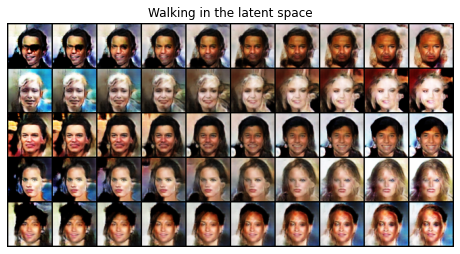

In [46]:
plt.figure(figsize=(8, 8))
plt.axis('off')
plt.title('Walking in the latent space')
plt.imshow(np.transpose(vutils.make_grid(fake, nrow=10, padding=2, normalize=True).cpu(), (1,2,0)))
plt.show()

In [19]:
# average list of latent space vectors
def average_points(points, ix):
    return np.mean(points[ix], axis=0)

In [52]:
f_smiling = [22, 24, 29, 30, 59]
f_neutral = [7, 9, 13, 18, 60]
f_short = [8, 26, 37, 41, 45]
f_long = [20, 25, 28, 35, 48]

In [53]:
noise_cpu = fixed_noise.detach().cpu().numpy()
avg_smiling = average_points(noise_cpu, f_smiling)
avg_neutral = average_points(noise_cpu, f_neutral)
avg_short = average_points(noise_cpu, f_short)
avg_long = average_points(noise_cpu, f_long)
avg_imgs = torch.from_numpy(np.stack([avg_smiling, avg_neutral, avg_short, avg_long])).to(device)

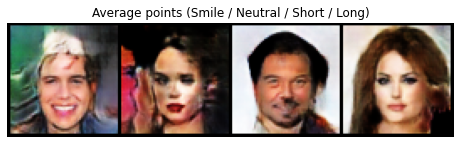

In [54]:
plt.figure(figsize=(8, 8))
plt.axis('off')
plt.title('Average points (Smile / Neutral / Short / Long)')
plt.imshow(np.transpose(vutils.make_grid(netG(avg_imgs), nrow=6, padding=2, normalize=True).cpu(), (1,2,0)))
plt.show()

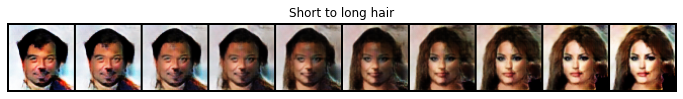

In [55]:
short_to_long = interpolate_points(torch.from_numpy(avg_short), torch.from_numpy(avg_long)).to(device)

plt.figure(figsize=(12, 2))
plt.axis('off')
plt.title('Short to long hair')
plt.imshow(np.transpose(vutils.make_grid(netG(short_to_long), nrow=10, padding=2, normalize=True).cpu(), (1,2,0)))
plt.show()

# Vector Arithmetic

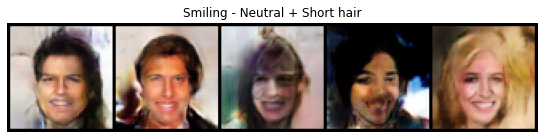

In [56]:
smiling_short = (fixed_noise[f_smiling] - fixed_noise[f_neutral] + fixed_noise[f_short]).to(device)

plt.figure(figsize=(12, 2))
plt.axis('off')
plt.title('Smiling - Neutral + Short hair')
plt.imshow(np.transpose(vutils.make_grid(netG(smiling_short), nrow=10, padding=2, normalize=True).cpu(), (1,2,0)))
plt.show()

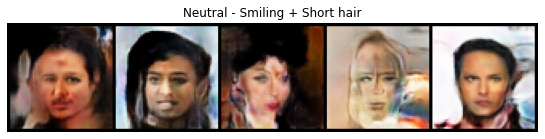

In [57]:
neutral_short = (fixed_noise[f_neutral] - fixed_noise[f_smiling] + fixed_noise[f_short]).to(device)

plt.figure(figsize=(12, 2))
plt.axis('off')
plt.title('Neutral - Smiling + Short hair')
plt.imshow(np.transpose(vutils.make_grid(netG(neutral_short), nrow=10, padding=2, normalize=True).cpu(), (1,2,0)))
plt.show()

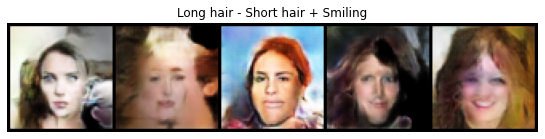

In [58]:
long_smiling = (fixed_noise[f_long] - fixed_noise[f_short] + fixed_noise[f_smiling]).to(device)

plt.figure(figsize=(12, 2))
plt.axis('off')
plt.title('Long hair - Short hair + Smiling')
plt.imshow(np.transpose(vutils.make_grid(netG(long_smiling), nrow=10, padding=2, normalize=True).cpu(), (1,2,0)))
plt.show()

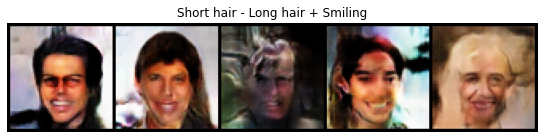

In [59]:
short_smiling = (fixed_noise[f_short] - fixed_noise[f_long] + fixed_noise[f_smiling]).to(device)

plt.figure(figsize=(12, 2))
plt.axis('off')
plt.title('Short hair - Long hair + Smiling')
plt.imshow(np.transpose(vutils.make_grid(netG(short_smiling), nrow=10, padding=2, normalize=True).cpu(), (1,2,0)))
plt.show()